In [1]:
import pandas as pd
import numpy as np
from functools import reduce

from sklearn.impute import KNNImputer
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import RandomForestClassifier
import hdbscan

from windrose import WindroseAxes, plot_windrose
import plotly.graph_objects as go
from umap import UMAP
import seaborn as sns
import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
from IPython.display import HTML, display

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Load In Data

In [3]:
pm25_csn_df = pd.read_csv('./hawthorne_data/PM25_CSN_Species_imputed.csv')
pm25_csn_df.drop(columns=['OC1', 'OC2', 'OC3', 'OC4', 'OP', 'EC1', 'EC2', 'EC3'], inplace=True)
pm25_csn_df.rename(columns={'Date.GMT':'date_gmt'}, inplace=True)
pm25_csn_df['date_gmt'] = pd.to_datetime(pm25_csn_df['date_gmt'])
pm25_csn_df['date_gmt'] = pm25_csn_df['date_gmt'].dt.date
pm25_csn_df['date_gmt'] = pd.to_datetime(pm25_csn_df['date_gmt'])
pm25_csn_df.head()

,date_gmt,Al,NH4,Sb,As,Ba,Br,Cd,Ca,Ce,Cs,Cl,Cr,Co,Cu,In,Fe,Pb,Mg,Mn,Ni,P,K,K+,Rb,Se,Si,Ag,Na,Na+,Sr,SO4,S,Sn,Ti,NO3,V,Zn,Zr,OC,EC,PM2.5
0,2000-02-09,0.117,1.7350,0.0095,0.00400,0.0295,0.01030,0.0065,0.2394,0.0435,0.023,0.0180,0.001,0.001,0.014,0.0070,0.28720,0.02190,0.009,0.00820,0.00780,0.00285,0.1092,0.1230,0.0013,0.00125,0.29580,0.0065,0.0195,0.168,0.00155,1.183,0.4130,0.0210,0.0191,6.015,0.00095,0.030,0.00920,5.015833,3.341,23.7
1,2000-02-15,0.005,0.0710,0.0095,0.00380,0.0610,0.00115,0.0065,0.0469,0.0430,0.023,0.0290,0.001,0.001,0.004,0.0070,0.07760,0.00315,0.009,0.00420,0.00210,0.00285,0.0092,0.0125,0.0013,0.00125,0.04830,0.0065,0.0400,0.091,0.00155,0.457,0.1071,0.0180,0.0019,0.358,0.00095,0.003,0.00230,1.315833,0.741,3.5
2,2000-02-21,0.005,0.0135,0.0095,0.00135,0.0300,0.00115,0.0070,0.0023,0.0435,0.023,0.0055,0.001,0.001,0.001,0.0075,0.00165,0.00315,0.009,0.00145,0.00095,0.00285,0.0021,0.0125,0.0013,0.00125,0.00415,0.0065,0.0420,0.162,0.00155,0.792,0.0020,0.0085,0.0019,0.601,0.00095,0.001,0.00235,1.155000,0.624,3.4
3,2000-02-27,0.017,0.1430,0.0095,0.00135,0.0295,0.00115,0.0065,0.0577,0.0435,0.023,0.0160,0.001,0.001,0.001,0.0075,0.13350,0.00740,0.009,0.00145,0.00270,0.00285,0.0182,0.0125,0.0013,0.00125,0.07740,0.0065,0.0195,0.094,0.00155,0.541,0.1339,0.0080,0.0019,0.459,0.00095,0.005,0.00235,0.965833,0.611,3.9
4,2000-03-04,0.005,2.7530,0.0095,0.00420,0.0990,0.00290,0.0070,0.1116,0.0435,0.023,0.0055,0.001,0.001,0.006,0.0075,0.20970,0.00840,0.028,0.00480,0.00095,0.00285,0.0407,0.0125,0.0013,0.00125,0.12660,0.0065,0.1800,0.085,0.00155,1.780,0.6480,0.0250,0.0081,8.801,0.00095,0.020,0.00235,3.390000,1.612,21.8


In [4]:
wind_speeds_hourly= pd.read_csv('./hawthorne_data/61101_2000To2023_1HourDuration.csv')
wind_directions_hourly = pd.read_csv('./hawthorne_data/61102_2000To2023_1HourDuration.csv')
wind_speeds_hourly['date_local'] = pd.to_datetime(wind_speeds_hourly['date_local'])
wind_directions_hourly['date_local'] = pd.to_datetime(wind_directions_hourly['date_local'])

/var/folders/dy/f5kv7gxj7_v68d_jzbw8q98h0000gp/T/ipykernel_79129/1937552065.py:1: DtypeWarning: Columns (27) have mixed types. Specify dtype option on import or set low_memory=False.
  wind_speeds_hourly= pd.read_csv('./hawthorne_data/61101_2000To2023_1HourDuration.csv')
/var/folders/dy/f5kv7gxj7_v68d_jzbw8q98h0000gp/T/ipykernel_79129/1937552065.py:2: DtypeWarning: Columns (27) have mixed types. Specify dtype option on import or set low_memory=False.
  wind_directions_hourly = pd.read_csv('./hawthorne_data/61102_2000To2023_1HourDuration.csv')


# DBSCAN Functions

In [5]:
def apply_hdbscan_clustering(df, min_cluster_size, min_samples=None):
    """
    Applies HDBSCAN clustering to the given DataFrame.

    Parameters:
        df (DataFrame): The input DataFrame containing features for clustering.
        min_cluster_size (int): The minimum size of clusters as per HDBSCAN.
        min_samples (int, optional): The number of samples in a neighborhood for a point to be considered a core point.

    Returns:
        DataFrame: A new DataFrame with an additional 'cluster' column indicating cluster assignments.
    """
    hdbscan_cluster = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)
    clusters = hdbscan_cluster.fit_predict(df)

    return_df = df.copy()
    return_df['cluster'] = clusters

    return return_df

def apply_hdbscan_clustering_minmaxscaler(df, min_cluster_size, min_samples=None):
    """
    Applies HDBSCAN clustering to the given DataFrame after scaling features using MinMaxScaler.

    Parameters:
        df (DataFrame): The input DataFrame containing features for clustering.
        min_cluster_size (int): The minimum size of clusters as per HDBSCAN.
        min_samples (int, optional): The number of samples in a neighborhood for a point to be considered a core point.

    Returns:
        DataFrame: A new DataFrame with an additional 'cluster' column indicating cluster assignments.
    """

    scaler = MinMaxScaler()
    features_scaled = scaler.fit_transform(df)

    # Applying HDBSCAN to the reduced features
    hdbscan_cluster = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)
    # clusters = hdbscan_cluster.fit_predict(features_scaled)
    clusters = hdbscan_cluster.fit_predict(features_scaled)

    # Adding the cluster results to the DataFrame copy
    return_df = df.copy()
    return_df['cluster'] = clusters

    return return_df

def apply_hdbscan_clustering_robustscaler(df, min_cluster_size, min_samples=None):
    """
    Applies HDBSCAN clustering to the given DataFrame after scaling features using RobustScaler.

    Parameters:
        df (DataFrame): The input DataFrame containing features for clustering.
        min_cluster_size (int): The minimum size of clusters as per HDBSCAN.
        min_samples (int, optional): The number of samples in a neighborhood for a point to be considered a core point.

    Returns:
        DataFrame: A new DataFrame with an additional 'cluster' column indicating cluster assignments.
    """
    scaler = RobustScaler()
    features_scaled = scaler.fit_transform(df)

    # Applying HDBSCAN to the reduced features
    hdbscan_cluster = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)
    # clusters = hdbscan_cluster.fit_predict(features_scaled)
    clusters = hdbscan_cluster.fit_predict(features_scaled)

    # Adding the cluster results to the DataFrame copy
    return_df = df.copy()
    return_df['cluster'] = clusters

    return return_df

def apply_hdbscan_clustering_standardscaler(df, min_cluster_size, min_samples=None):
    """
    Applies HDBSCAN clustering to the given DataFrame afterscaling features using StandardScaler.

    Parameters:
        df (DataFrame): The input DataFrame containing features for clustering.
        min_cluster_size (int): The minimum size of clusters as per HDBSCAN.
        min_samples (int, optional): The number of samples in a neighborhood for a point to be considered a core point.

    Returns:
        DataFrame: A new DataFrame with an additional 'cluster' column indicating cluster assignments.
    """
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(df)

    # Applying HDBSCAN to the reduced features
    hdbscan_cluster = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)
    # clusters = hdbscan_cluster.fit_predict(features_scaled)
    clusters = hdbscan_cluster.fit_predict(features_scaled)

    # Adding the cluster results to the DataFrame copy
    return_df = df.copy()
    return_df['cluster'] = clusters

    return return_df

def apply_hdbscan_clustering_normalizer(df, min_cluster_size, min_samples=None):
    """
    Applies HDBSCAN clustering to the given DataFrame after normalizing rows.

    Parameters:
        df (DataFrame): The input DataFrame containing features for clustering.
        min_cluster_size (int): The minimum size of clusters as per HDBSCAN.
        min_samples (int, optional): The number of samples in a neighborhood for a point to be considered a core point.

    Returns:
        DataFrame: A new DataFrame with an additional 'cluster' column indicating cluster assignments.
    """
    normed_df = normalize(df, norm='l2')

    hdbscan_cluster = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)
    clusters = hdbscan_cluster.fit_predict(normed_df)

    return_df = df.copy()
    return_df['cluster'] = clusters

    return return_df

# Helper Functions

In [6]:
def impute_missing_values(df):
    """
    Impute missing values in a DataFrame using K-Nearest Neighbors.

    Parameters:
    df (pd.DataFrame): The DataFrame containing missing values to be imputed.

    Returns:
    pd.DataFrame: A DataFrame with missing values imputed.
    """
    imputer = KNNImputer(n_neighbors=5)
    df_imputed = pd.DataFrame(imputer.fit_transform(df), columns=df.columns, index=df.index)
    return df_imputed

In [7]:
def get_season(date):
    """
    Determine the season based on a given date.

    The function assigns a season to a date as follows:
    - 'Winter' for December, January, and February.
    - 'Spring' for March, April, and May.
    - 'Summer' for June, July, and August.
    - 'Fall' for September, October, and November.

    Parameters:
    date (datetime): The date for which the season needs to be determined.

    Returns:
    str: A string representing the season for the given date.
    """
    year = date.year
    if date.month in (12, 1, 2):
        season = f'Winter'
    elif date.month in (3, 4, 5):
        season = f'Spring'
    elif date.month in (6, 7, 8):
        season = f'Summer'
    else:
        season = f'Fall'
    return season

In [8]:
def plot_windrose_subplots(data, *, direction, var, color=None, **kwargs):
    """
    Plots a windrose subplot using given wind data and direction.

    Parameters:
    data (DataFrame): The dataset containing wind measurements.
    direction (str): Column name in `data` for wind directions.
    var (str): Column name in `data` for wind speed or other variable.
    color (str, optional): Color of the bars in the windrose plot.
    **kwargs: Additional keyword arguments for `plot_windrose` function.
    """
    ax = plt.gca()
    ax = WindroseAxes.from_ax(ax=ax)
    plot_windrose(direction_or_df=data[direction], var=data[var], ax=ax, **kwargs)

In [9]:
def create_cluster_windrose_plots(cluster_matrix, wind_speeds, wind_directions):
    """
    Generates windrose plots for each cluster based on wind speed and direction data.

    Parameters:
    cluster_matrix (DataFrame): DataFrame containing cluster assignments with datetime index.
    wind_speeds (DataFrame): DataFrame containing wind speed measurements with datetime index.
    wind_directions (DataFrame): DataFrame containing wind direction measurements with datetime index.
    
    The function processes the wind data, merges relevant measurements based on cluster-specific dates, and uses the 
    `plot_windrose_subplots` function to generate individual windrose plots for each cluster.
    """
    all_clusters_data = []
    for cluster in cluster_matrix['cluster'].unique():
        cluster_df = cluster_matrix[cluster_matrix['cluster'] == cluster]
        cluster_dates = cluster_df.index
    
        hourly_wind_speeds = wind_speeds[wind_speeds['date_local'].isin(cluster_dates)]
        hourly_wind_directions = wind_directions[wind_directions['date_local'].isin(cluster_dates)]
    
        combined_df = pd.merge(hourly_wind_speeds, hourly_wind_directions, on='date_local', suffixes=('_speed', '_direction'))
        combined_df['cluster'] = cluster  
        all_clusters_data.append(combined_df)
    
    all_clusters_data = pd.concat(all_clusters_data)
    
    # Setup FacetGrid
    g = sns.FacetGrid(
        data=all_clusters_data,
        # the column name for each level a subplot should be created
        col="cluster",
        # place a maximum of 3 plots per row
        col_wrap=3,
        subplot_kws={"projection": "windrose"},
        sharex=False,
        sharey=False,
        despine=False,
        height=4,)
    g.map_dataframe(
        plot_windrose_subplots,
        direction="sample_measurement_direction",
        var="sample_measurement_speed",
        normed=True,
        # manually set bins, so they match for each subplot
        bins=(0, 3, 6, 9, 12, 15),
        calm_limit=0.1,
        kind="bar",
    )
    
    y_ticks = range(0, 25, 4)
    for ax in g.axes:
        ax.set_legend(
            title=r"$m \cdot s^{-1}$", bbox_to_anchor=(1.35, -0.1), loc="lower right"
        )
        ax.set_rgrids(y_ticks, y_ticks)
    
    # adjust the spacing between the subplots to have sufficient space between plots
    plt.subplots_adjust(wspace=0.5)

In [10]:
def find_best_k(data):
    """
    Determines the optimal number of clusters (k) for KMeans clustering using the elbow method.

    Parameters:
    data (array-like): Numerical data used for clustering in KMeans. The data should be scaled if necessary prior to passing to this function.
    """
    sum_of_squared_distances = []
    K=range(1,20)
    for k in K:
        km=KMeans(n_clusters=k)
        km=km.fit(data)
        sum_of_squared_distances.append(km.inertia_)
    plt.plot(K, sum_of_squared_distances, 'bx-')
    plt.xlabel('k')
    plt.ylabel('sum_of_squared_distances')
    plt.title('Elbow method for optimal k')
    plt.show()  

# HDBSCAN On Filtered PM2.5 Species Without PM2.5 Concentrations

### Set Up Data and Assign Clusters

In [11]:
filtered_species_df = pm25_csn_df.copy()
filtered_species_df.set_index('date_gmt', inplace=True)
filtered_species_df = filtered_species_df.filter(['Al', 'Br', 'Ca', 'Cr', 'Cu', 'Cl', 'Fe', 'Pb', 'Mn', 'Ni', 'Mg', 'Ti', 'V', 'Si', 'Zn', 'K', 'Na', 'NH4', 'NO3', 'OC', 'EC', 'SO4'])
filtered_species_df.head()

,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4
date_gmt,,,,,,,,,,,,,,,,,,,,,,
2000-02-09,0.117,0.01030,0.2394,0.001,0.014,0.0180,0.28720,0.02190,0.00820,0.00780,0.009,0.0191,0.00095,0.29580,0.030,0.1092,0.0195,1.7350,6.015,5.015833,3.341,1.183
2000-02-15,0.005,0.00115,0.0469,0.001,0.004,0.0290,0.07760,0.00315,0.00420,0.00210,0.009,0.0019,0.00095,0.04830,0.003,0.0092,0.0400,0.0710,0.358,1.315833,0.741,0.457
2000-02-21,0.005,0.00115,0.0023,0.001,0.001,0.0055,0.00165,0.00315,0.00145,0.00095,0.009,0.0019,0.00095,0.00415,0.001,0.0021,0.0420,0.0135,0.601,1.155000,0.624,0.792
2000-02-27,0.017,0.00115,0.0577,0.001,0.001,0.0160,0.13350,0.00740,0.00145,0.00270,0.009,0.0019,0.00095,0.07740,0.005,0.0182,0.0195,0.1430,0.459,0.965833,0.611,0.541
2000-03-04,0.005,0.00290,0.1116,0.001,0.006,0.0055,0.20970,0.00840,0.00480,0.00095,0.028,0.0081,0.00095,0.12660,0.020,0.0407,0.1800,2.7530,8.801,3.390000,1.612,1.780


In [12]:
filtered_species_clusters = apply_hdbscan_clustering_normalizer(df=filtered_species_df, min_cluster_size=6, min_samples=6)
print(filtered_species_clusters['cluster'].value_counts())

cluster
-1    1447
 2     475
 8     325
 5      18
 3      13
 4      12
 7       9
 0       7
 6       6
 1       6
Name: count, dtype: int64


### Use UMAP to Visualize Cluster Assignments
- Used as a sanity check
- Should not be used to check algorithm performance or metrics

In [13]:
normed_df = normalize(filtered_species_df, norm='l2')

umap_3d = UMAP(n_components=3, init='random')
proj_3d = umap_3d.fit_transform(normed_df)

# Plotting
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], y=proj_3d[:, 1], z=proj_3d[:, 2],
    color=filtered_species_clusters['cluster'].astype(str), 
    labels={'color': 'Cluster'},
    title='3D Scatter Plot of Clusters'
)
fig_3d.update_traces(marker=dict(size=2))
fig_3d.show()

### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [14]:
filtered_species_clusters['Season'] = filtered_species_clusters.index.map(get_season)
filtered_species_seasonal_cluster_counts = filtered_species_clusters.groupby(['Season', 'cluster']).size().unstack(fill_value=0)
filtered_species_seasonal_cluster_counts

cluster,-1,0,1,2,3,4,5,6,7,8
Season,,,,,,,,,,
Fall,362,0,3,113,12,8,12,3,3,52
Spring,513,3,3,35,1,0,4,1,1,26
Summer,240,0,0,325,0,0,0,0,0,0
Winter,332,4,0,2,0,4,2,2,5,247


In [15]:
filtered_species_seasonal_cluster_counts.reset_index(inplace=True)

# Exclude cluster -1 from the DataFrame
filtered_df = filtered_species_seasonal_cluster_counts.loc[:, filtered_species_seasonal_cluster_counts.columns != -1]

# Melt the DataFrame to have clusters as one of the dimensions
melted_df = filtered_df.melt(id_vars='Season', var_name='cluster', value_name='Number of Days')

# Plotting using Plotly Express
fig = px.bar(melted_df, x='cluster', y='Number of Days', color='Season',
             labels={'cluster': 'Cluster', 'Number of Days': 'Number of Days'},
             title='Seasonal Distribution Across Clusters (excluding Cluster -1)',
             color_discrete_map={'Winter': '#007291', 'Spring': '#359c00', 'Summer': '#f5c600', 'Fall': '#d8460b'},
             barmode='group')

fig.show()

### Plot Species Distributions Amongst Clusters
- Used for comparing species distributions within clusters
- Helpful for beginning to profile different clusters
- Distributions can be compared to previous source apportionment studies to aid in profiling

In [16]:
species_columns = filtered_species_clusters.columns.difference(['cluster'])
unique_clusters = sorted(filtered_species_clusters['cluster'].unique())

# Include Plotly JS only once in the entire document, ideally in the first cell where a plot is generated
plotly_js_included = False

for cluster in unique_clusters:
    # Filter the DataFrame for the current cluster
    cluster_data = filtered_species_clusters[filtered_species_clusters['cluster'] == cluster]
    
    melted_data = cluster_data.melt(id_vars='cluster', value_vars=species_columns, var_name='Species', value_name='Concentration')
    
    fig = px.box(melted_data, x='Species', y='Concentration',
                 title=f'Distribution of PM2.5 Species in Cluster {cluster}',
                 labels={'Species': 'PM2.5 Species', 'Concentration': 'Concentration (ppm)'})
    fig.update_layout(
        height=800,
        width=5000)
    fig.update_xaxes(categoryorder='total descending')
    
    # Ensure that Plotly JS is only included once
    if not plotly_js_included:
        display_html = fig.to_html(full_html=False, include_plotlyjs='cdn')
        plotly_js_included = True
    else:
        display_html = fig.to_html(full_html=False, include_plotlyjs=False)
    
    # Display the plot with horizontal scrolling
    display(HTML('<div style="width: 1000px; overflow-x: auto;">' + display_html + '</div>'))

### Plot Cluster Distributions Amongst Species
- Used for comparing cluster distributions to one another for particular species
- Helpful for cluster comparison to better identify and differentiate cluster qualities

In [17]:
species_columns = filtered_species_clusters.columns.difference(['cluster'])

# Create a box plot for each species
for species in species_columns:
    fig = px.box(filtered_species_clusters, x='cluster', y=species,
                 title=f'Distribution of {species} by Cluster',
                 labels={'cluster': 'Cluster', species: f'{species} Concentration'},
                 category_orders={"cluster": sorted(filtered_species_clusters['cluster'].unique())})
    fig.update_layout(height=400)
    fig.show()

### Create Heatmap of Species' Log-Distributions Across Clusters
- Easier way to compare species' distributions amongst clusters
- Log scale is used to prevent the domination of one species (PM2.5 has much larger concentrations than other species)

In [18]:
columns_to_include = filtered_species_clusters.columns.difference(['Season', 'cluster'])
custom_order = ['OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_clusters.groupby('cluster')[columns_to_include_ordered].median()

log_scaled_concentrations = np.log(median_concentrations)

fig = px.imshow(
    log_scaled_concentrations,
    labels=dict(x="Pollutant Types", y="Cluster", color="Log-scaled Concentration"),
    x=log_scaled_concentrations.columns,  # pollutant types as columns
    y=log_scaled_concentrations.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (HDBSCAN Without PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Log-scaled Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(log_scaled_concentrations.index),
        ticktext=[f"Cluster {c}" for c in log_scaled_concentrations.index]
    )
)

fig.show()

### Create Heatmap of Normalized Species' Concentrations
- Used for comparing species' concentrations across clusters
- Should not be used to determine actual concentration values

In [19]:
columns_to_include = filtered_species_clusters.columns.difference(['Season', 'cluster'])
custom_order = ['OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_clusters.groupby('cluster')[columns_to_include_ordered].median()

scaler = MinMaxScaler()
median_concentrations_normalized = pd.DataFrame(scaler.fit_transform(median_concentrations),
                                                index=median_concentrations.index, 
                                                columns=columns_to_include_ordered)

fig = px.imshow(
    median_concentrations_normalized,
    labels=dict(x="Pollutant Types", y="Cluster", color="Normalized Concentration"),
    x=median_concentrations_normalized.columns,  # pollutant types as columns
    y=median_concentrations_normalized.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (HDBSCAN Without PM2.5 Concentrations",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Normalized Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(median_concentrations_normalized.index),
        ticktext=[f"Cluster {c}" for c in median_concentrations_normalized.index]
    )
)

fig.show()

### Create Windrose Plots for Each Cluster
- Helpful for confirming/developing cluster profiles
- i.e. Winter inversion cluster should have low wind speeds 

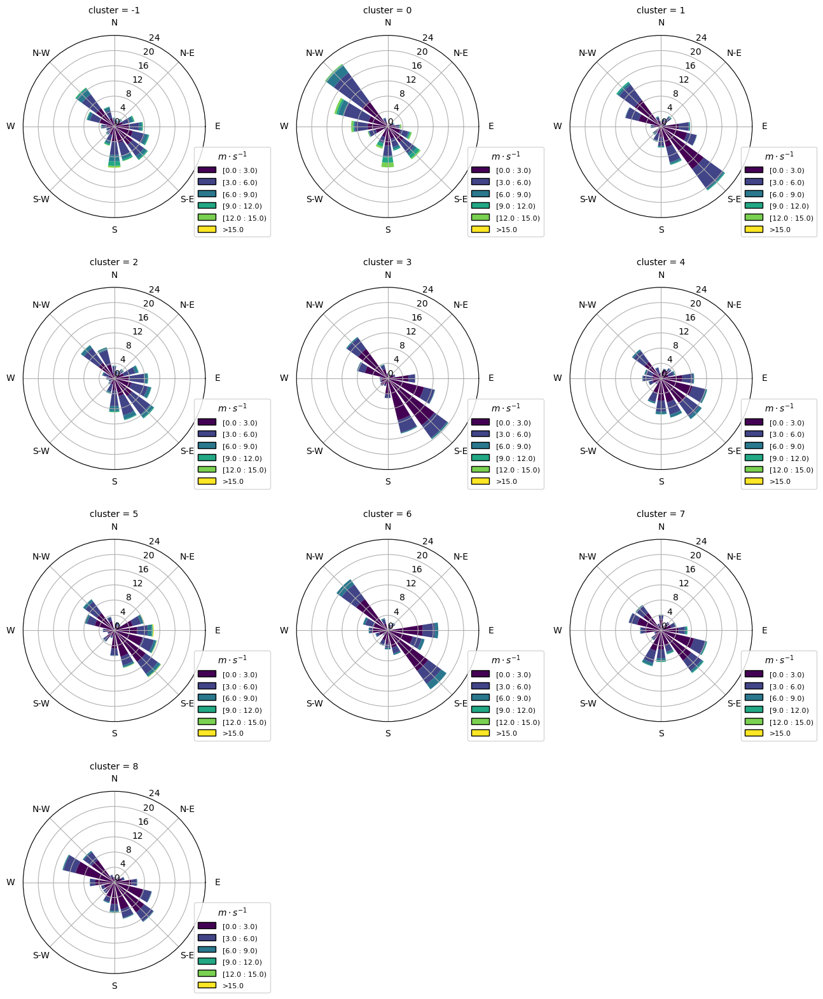

In [20]:
create_cluster_windrose_plots(filtered_species_clusters, wind_speeds_hourly, wind_directions_hourly)

<h1>HDBSCAN On Filtered PM2.5 Species With PM2.5 Concentrations</h1>

### Set Up Data and Assign Clusters

In [21]:
filtered_species_df_25 = pm25_csn_df.copy()
filtered_species_df_25.set_index('date_gmt', inplace=True)
filtered_species_df_25 = filtered_species_df_25.filter(['PM2.5', 'Al', 'Br', 'Ca', 'Cr', 'Cu', 'Cl', 'Fe', 'Pb', 'Mn', 'Ni', 'Mg', 'Ti', 'V', 'Si', 'Zn', 'K', 'Na', 'NH4', 'NO3', 'OC', 'EC', 'SO4'])
filtered_species_df_25.head()

,PM2.5,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4
date_gmt,,,,,,,,,,,,,,,,,,,,,,,
2000-02-09,23.7,0.117,0.01030,0.2394,0.001,0.014,0.0180,0.28720,0.02190,0.00820,0.00780,0.009,0.0191,0.00095,0.29580,0.030,0.1092,0.0195,1.7350,6.015,5.015833,3.341,1.183
2000-02-15,3.5,0.005,0.00115,0.0469,0.001,0.004,0.0290,0.07760,0.00315,0.00420,0.00210,0.009,0.0019,0.00095,0.04830,0.003,0.0092,0.0400,0.0710,0.358,1.315833,0.741,0.457
2000-02-21,3.4,0.005,0.00115,0.0023,0.001,0.001,0.0055,0.00165,0.00315,0.00145,0.00095,0.009,0.0019,0.00095,0.00415,0.001,0.0021,0.0420,0.0135,0.601,1.155000,0.624,0.792
2000-02-27,3.9,0.017,0.00115,0.0577,0.001,0.001,0.0160,0.13350,0.00740,0.00145,0.00270,0.009,0.0019,0.00095,0.07740,0.005,0.0182,0.0195,0.1430,0.459,0.965833,0.611,0.541
2000-03-04,21.8,0.005,0.00290,0.1116,0.001,0.006,0.0055,0.20970,0.00840,0.00480,0.00095,0.028,0.0081,0.00095,0.12660,0.020,0.0407,0.1800,2.7530,8.801,3.390000,1.612,1.780


In [22]:
filtered_species_clusters_25 = apply_hdbscan_clustering_normalizer(df=filtered_species_df_25, min_cluster_size=5, min_samples=5)
print(filtered_species_clusters_25['cluster'].value_counts())

cluster
-1    1245
 1     533
 5     502
 3      13
 2      12
 0       7
 4       6
Name: count, dtype: int64


### Use UMAP to Visualize Cluster Assignments
- Used as a sanity check
- Should not be used to check algorithm performance or metrics

In [23]:
features_reduced_25 = normalize(filtered_species_df_25, norm='l2')

umap_3d = UMAP(n_components=3, init='random')
proj_3d = umap_3d.fit_transform(features_reduced_25)

# Plotting
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], y=proj_3d[:, 1], z=proj_3d[:, 2],
    color=filtered_species_clusters_25['cluster'].astype(str), 
    labels={'color': 'Cluster'},
    title='3D Scatter Plot of Clusters'
)
fig_3d.update_traces(marker=dict(size=2))
fig_3d.show()

### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [24]:
filtered_species_clusters_25['Season'] = filtered_species_clusters_25.index.map(get_season)
filtered_species_seasonal_cluster_counts_25 = filtered_species_clusters_25.groupby(['Season', 'cluster']).size().unstack(fill_value=0)
filtered_species_seasonal_cluster_counts_25

cluster,-1,0,1,2,3,4,5
Season,,,,,,,
Fall,305,4,132,1,9,3,114
Spring,448,0,58,7,2,3,69
Summer,243,0,0,3,0,0,319
Winter,249,3,343,1,2,0,0


In [25]:
filtered_species_seasonal_cluster_counts_25.reset_index(inplace=True)

# Exclude cluster -1 from the DataFrame
filtered_df_25 = filtered_species_seasonal_cluster_counts_25.loc[:, filtered_species_seasonal_cluster_counts_25.columns != -1]

# Melt the DataFrame to have clusters as one of the dimensions
melted_df = filtered_df_25.melt(id_vars='Season', var_name='cluster', value_name='Number of Days')

# Plotting using Plotly Express
fig = px.bar(melted_df, x='cluster', y='Number of Days', color='Season',
             labels={'cluster': 'Cluster', 'Number of Days': 'Number of Days'},
             title='Seasonal Distribution Across Clusters (excluding Cluster -1)',
             color_discrete_map={'Winter': '#007291', 'Spring': '#359c00', 'Summer': '#f5c600', 'Fall': '#d8460b'},
             barmode='group')

fig.show()

### Plot Species Distributions Amongst Clusters
- Used for comparing species distributions within clusters
- Helpful for beginning to profile different clusters
- Distributions can be compared to previous source apportionment studies to aid in profiling

In [26]:
species_columns = filtered_species_clusters_25.columns.difference(['cluster', 'PM2.5'])
unique_clusters = sorted(filtered_species_clusters_25['cluster'].unique())
for cluster in unique_clusters:
    # Filter the DataFrame for the current cluster
    cluster_data = filtered_species_clusters_25[filtered_species_clusters_25['cluster'] == cluster]
    
    melted_data = cluster_data.melt(id_vars='cluster', value_vars=species_columns, var_name='Species', value_name='Concentration')
    
    fig = px.box(melted_data, x='Species', y='Concentration',
                 title=f'Distribution of PM2.5 Species in Cluster {cluster}',
                 labels={'Species': 'PM2.5 Species', 'Concentration': 'Concentration (ppm)'})
    fig.update_layout(
        height=800,
        width=5000)
    fig.update_xaxes(categoryorder='total descending')
    
    display(HTML('<div style="width: 1000px; overflow-x: auto;">' + fig.to_html(include_plotlyjs='cdn') + '</div>'))

### Plot Cluster Distributions Amongst Species
- Used for comparing cluster distributions to one another for particular species
- Helpful for cluster comparison to better identify and differentiate cluster qualities

In [27]:
 species_columns = filtered_species_clusters_25.columns.difference(['cluster', 'Season'])

# Exclude cluster -1
filtered_df = filtered_species_clusters_25[filtered_species_clusters_25['cluster'] != -1]

# Create a box plot for each species
for species in species_columns:
    fig = px.box(filtered_df, x='cluster', y=species,
                 title=f'Distribution of {species} by Cluster',
                 labels={'cluster': 'Cluster', species: f'{species} Concentration'},
                 category_orders={"cluster": sorted(filtered_species_clusters_25['cluster'].unique())})
    fig.update_layout(height=400)
    fig.show()

In [28]:
for species in species_columns:
    # Calculate mean and median grouped by cluster
    stats_df = filtered_df.groupby('cluster')[species].agg(['mean', 'median']).reset_index()

    # Create a figure with subplots for mean and median
    fig = go.Figure(data=[
        go.Bar(name='Mean', x=stats_df['cluster'], y=stats_df['mean'], marker_color='#FFBF00'),
        go.Bar(name='Median', x=stats_df['cluster'], y=stats_df['median'], marker_color='#6495ED')
    ])
    
    # Update the layout
    fig.update_layout(
        barmode='group',
        title=f'Distribution of {species} by Cluster: Means and Medians',
        xaxis_title='Cluster',
        yaxis_title=f'{species} Concentration',
        height=400
    )

    fig.show()

### Create Heatmap of Species' Log-Distributions Across Clusters
- Easier way to compare species' distributions amongst clusters
- Log scale is used to prevent the domination of one species (PM2.5 has much larger concentrations than other species)

In [29]:
columns_to_include = filtered_species_clusters_25.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_clusters_25.groupby('cluster')[columns_to_include_ordered].median()

log_scaled_concentrations = np.log(median_concentrations)

fig = px.imshow(
    log_scaled_concentrations,
    labels=dict(x="Pollutant Types", y="Cluster", color="Log-scaled Concentration"),
    x=log_scaled_concentrations.columns,  # pollutant types as columns
    y=log_scaled_concentrations.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (HDBSCAN With PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Log-scaled Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(log_scaled_concentrations.index),
        ticktext=[f"Cluster {c}" for c in log_scaled_concentrations.index]
    )
)

fig.show()

### Create Heatmap of Normalized Species' Concentrations
- Used for comparing species' concentrations across clusters
- Should not be used to determine actual concentration values

In [30]:
columns_to_include = filtered_species_clusters_25.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_clusters_25.groupby('cluster')[columns_to_include_ordered].median()

scaler = MinMaxScaler()
median_concentrations_normalized = pd.DataFrame(scaler.fit_transform(median_concentrations),
                                                index=median_concentrations.index, 
                                                columns=columns_to_include_ordered)

fig = px.imshow(
    median_concentrations_normalized,
    labels=dict(x="Pollutant Types", y="Cluster", color="Normalized Concentration"),
    x=median_concentrations_normalized.columns,  # pollutant types as columns
    y=median_concentrations_normalized.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (HDBSCAN With PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Normalized Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(median_concentrations_normalized.index),
        ticktext=[f"Cluster {c}" for c in median_concentrations_normalized.index]
    )
)

fig.show()

### Create Windrose Plots for Each Cluster
- Helpful for confirming/developing cluster profiles
- i.e. Winter inversion cluster should have low wind speeds

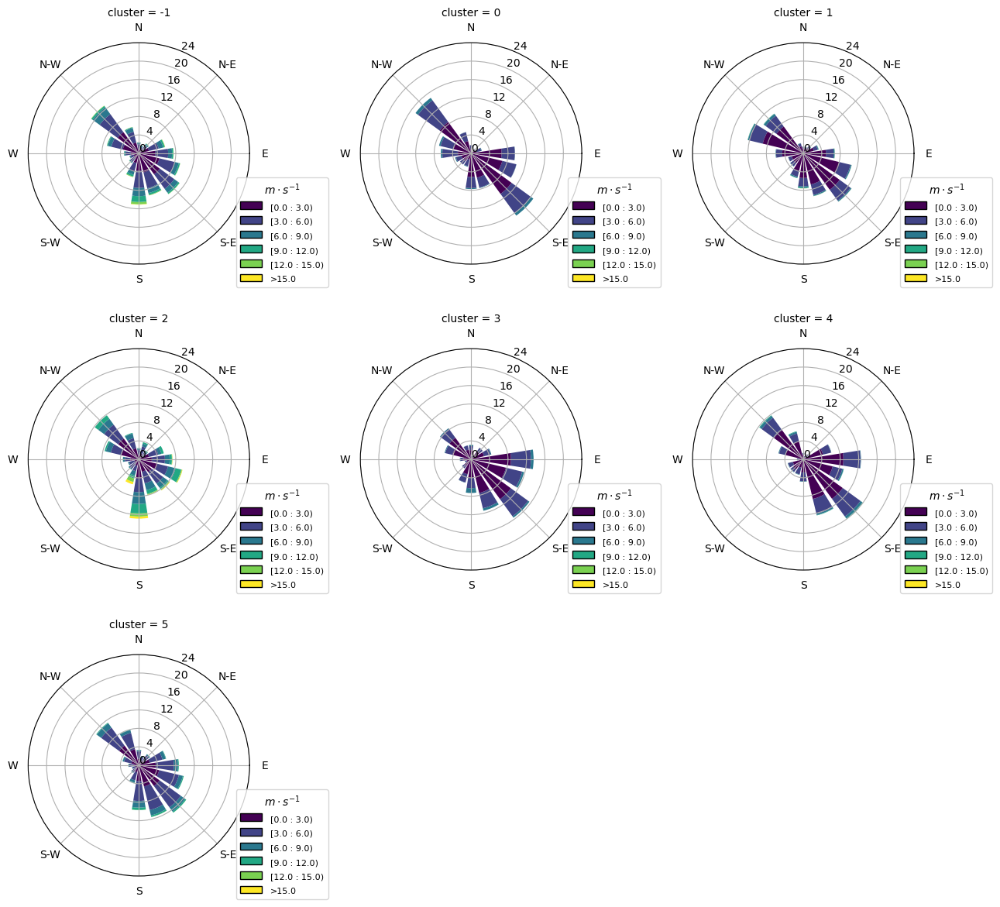

In [31]:
create_cluster_windrose_plots(filtered_species_clusters_25, wind_speeds_hourly, wind_directions_hourly)

<h1>KMeans On Filtered PM2.5 Species Without PM2.5 Concentrations</h1>

### Set Up Data, Assign Clusters, and Use UMAP to Visualize Cluster Assignments
- Using elbow method on normalized features to determine the 'optimal' number of clusters (k)
- UMAP Visualization used as a sanity check
- Visualization should not be used to check algorithm performance or metrics

In [32]:
filtered_species_df = pm25_csn_df.copy()
filtered_species_df.set_index('date_gmt', inplace=True)
filtered_species_df = filtered_species_df.filter(['Al', 'Br', 'Ca', 'Cr', 'Cu', 'Cl', 'Fe', 'Pb', 'Mn', 'Ni', 'Mg', 'Ti', 'V', 'Si', 'Zn', 'K', 'Na', 'NH4', 'NO3', 'OC', 'EC', 'SO4'])
filtered_species_df.head()

,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4
date_gmt,,,,,,,,,,,,,,,,,,,,,,
2000-02-09,0.117,0.01030,0.2394,0.001,0.014,0.0180,0.28720,0.02190,0.00820,0.00780,0.009,0.0191,0.00095,0.29580,0.030,0.1092,0.0195,1.7350,6.015,5.015833,3.341,1.183
2000-02-15,0.005,0.00115,0.0469,0.001,0.004,0.0290,0.07760,0.00315,0.00420,0.00210,0.009,0.0019,0.00095,0.04830,0.003,0.0092,0.0400,0.0710,0.358,1.315833,0.741,0.457
2000-02-21,0.005,0.00115,0.0023,0.001,0.001,0.0055,0.00165,0.00315,0.00145,0.00095,0.009,0.0019,0.00095,0.00415,0.001,0.0021,0.0420,0.0135,0.601,1.155000,0.624,0.792
2000-02-27,0.017,0.00115,0.0577,0.001,0.001,0.0160,0.13350,0.00740,0.00145,0.00270,0.009,0.0019,0.00095,0.07740,0.005,0.0182,0.0195,0.1430,0.459,0.965833,0.611,0.541
2000-03-04,0.005,0.00290,0.1116,0.001,0.006,0.0055,0.20970,0.00840,0.00480,0.00095,0.028,0.0081,0.00095,0.12660,0.020,0.0407,0.1800,2.7530,8.801,3.390000,1.612,1.780


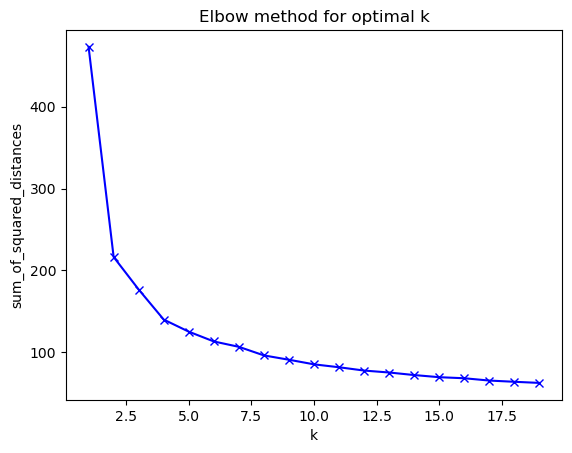

In [33]:
features_normed = normalize(filtered_species_df, norm='l2')

find_best_k(features_normed)

In [34]:
optimal_k = 7
kmeans = KMeans(n_clusters=optimal_k)
clusters = kmeans.fit_predict(features_normed)

filtered_species_kmeansclusters = filtered_species_df.copy()
filtered_species_kmeansclusters['cluster'] = clusters
print(filtered_species_kmeansclusters['cluster'].value_counts())

# Reduce dimensions for visualization with UMAP
umap_3d = UMAP(n_components=3, init='random')
proj_3d = umap_3d.fit_transform(features_normed)

# Plotting with Plotly
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], y=proj_3d[:, 1], z=proj_3d[:, 2],
    color=filtered_species_kmeansclusters['cluster'].astype(str), 
    labels={'color': 'Cluster'},
    title='3D Scatter Plot of Clusters'
)
fig_3d.update_traces(marker=dict(size=2))
fig_3d.show()

cluster
3    460
0    449
1    429
4    357
5    341
6    156
2    126
Name: count, dtype: int64


### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [35]:
filtered_species_kmeansclusters['Season'] = filtered_species_kmeansclusters.index.map(get_season)
seasonal_kmeans_cluster_counts = filtered_species_kmeansclusters.groupby(['Season', 'cluster']).size().unstack(fill_value=0)
seasonal_kmeans_cluster_counts

cluster,0,1,2,3,4,5,6
Season,,,,,,,
Fall,132,51,15,82,111,158,19
Spring,39,66,83,134,77,98,90
Summer,268,0,2,240,0,14,41
Winter,10,312,26,4,169,71,6


In [36]:
seasonal_kmeans_cluster_counts.reset_index(inplace=True)

# Exclude cluster -1 from the DataFrame
filtered_kmeans_df = seasonal_kmeans_cluster_counts.loc[:, seasonal_kmeans_cluster_counts.columns != -1]

# Melt the DataFrame to have clusters as one of the dimensions
melted_df = filtered_kmeans_df.melt(id_vars='Season', var_name='cluster', value_name='Number of Days')

# Plotting using Plotly Express
fig = px.bar(melted_df, x='cluster', y='Number of Days', color='Season',
             labels={'cluster': 'Cluster', 'Number of Days': 'Number of Days'},
             title='Seasonal Distribution Across Clusters',
             color_discrete_map={'Winter': '#007291', 'Spring': '#359c00', 'Summer': '#f5c600', 'Fall': '#d8460b'},
             barmode='group')

fig.show()

### Plot Species Distributions Amongst Clusters
- Used for comparing species distributions within clusters
- Helpful for beginning to profile different clusters
- Distributions can be compared to previous source apportionment studies to aid in profiling

In [37]:
species_columns = filtered_species_kmeansclusters.columns.difference(['cluster'])
unique_clusters = sorted(filtered_species_kmeansclusters['cluster'].unique())
for cluster in unique_clusters:
    # Filter the DataFrame for the current cluster
    cluster_data = filtered_species_kmeansclusters[filtered_species_kmeansclusters['cluster'] == cluster]
    
    melted_data = cluster_data.melt(id_vars='cluster', value_vars=species_columns, var_name='Species', value_name='Concentration')
    
    fig = px.box(melted_data, x='Species', y='Concentration',
                 title=f'Distribution of PM2.5 Species in Cluster {cluster}',
                 labels={'Species': 'PM2.5 Species', 'Concentration': 'Concentration (ppm)'})
    fig.update_layout(
        height=800,
        width=5000)
    fig.update_xaxes(categoryorder='total descending')
    
    display(HTML('<div style="width: 1000px; overflow-x: auto;">' + fig.to_html(include_plotlyjs='cdn') + '</div>'))

### Plot Cluster Distributions Amongst Species
- Used for comparing cluster distributions to one another for particular species
- Helpful for cluster comparison to better identify and differentiate cluster qualities

In [38]:
 species_columns = filtered_species_kmeansclusters.columns.difference(['cluster', 'Season'])

# Exclude cluster -1
filtered_df = filtered_species_kmeansclusters[filtered_species_kmeansclusters['cluster'] != -1]

# Create a box plot for each species
for species in species_columns:
    fig = px.box(filtered_df, x='cluster', y=species,
                 title=f'Distribution of {species} by Cluster',
                 labels={'cluster': 'Cluster', species: f'{species} Concentration'},
                 category_orders={"cluster": sorted(filtered_species_kmeansclusters['cluster'].unique())})
    fig.update_layout(height=400)
    fig.show()

In [39]:
for species in species_columns:
    # Calculate mean and median grouped by cluster
    stats_df = filtered_species_kmeansclusters.groupby('cluster')[species].agg(['mean', 'median']).reset_index()

    # Create a figure with subplots for mean and median
    fig = go.Figure(data=[
        go.Bar(name='Mean', x=stats_df['cluster'], y=stats_df['mean'], marker_color='#FFBF00'),
        go.Bar(name='Median', x=stats_df['cluster'], y=stats_df['median'], marker_color='#6495ED')
    ])
    
    # Update the layout
    fig.update_layout(
        barmode='group',
        title=f'Distribution of {species} by Cluster: Means and Medians',
        xaxis_title='Cluster',
        yaxis_title=f'{species} Concentration',
        height=400
    )
    
    fig.show()

### Create Heatmap of Species' Log-Distributions Across Clusters
- Easier way to compare species' distributions amongst clusters
- Log scale is used to prevent the domination of one species (PM2.5 has much larger concentrations than other species)

In [40]:
columns_to_include = filtered_species_kmeansclusters.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_kmeansclusters.groupby('cluster')[columns_to_include_ordered].median()

log_scaled_concentrations = np.log(median_concentrations)

fig = px.imshow(
    log_scaled_concentrations,
    labels=dict(x="Pollutant Types", y="Cluster", color="Log-scaled Concentration"),
    x=log_scaled_concentrations.columns,  # pollutant types as columns
    y=log_scaled_concentrations.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (K-MEANS Without PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Log-scaled Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(log_scaled_concentrations.index),
        ticktext=[f"Cluster {c}" for c in log_scaled_concentrations.index]
    )
)

fig.show()

### Create Heatmap of Normalized Species' Concentrations
- Used for comparing species' concentrations across clusters
- Should not be used to determine actual concentration values

In [41]:
columns_to_include = filtered_species_kmeansclusters.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_kmeansclusters.groupby('cluster')[columns_to_include_ordered].median()

scaler = MinMaxScaler()
median_concentrations_normalized = pd.DataFrame(scaler.fit_transform(median_concentrations),
                                                index=median_concentrations.index, 
                                                columns=columns_to_include_ordered)

fig = px.imshow(
    median_concentrations_normalized,
    labels=dict(x="Pollutant Types", y="Cluster", color="Normalized Concentration"),
    x=median_concentrations_normalized.columns,  # pollutant types as columns
    y=median_concentrations_normalized.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (K-MEANS Without PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Normalized Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(median_concentrations_normalized.index),
        ticktext=[f"Cluster {c}" for c in median_concentrations_normalized.index]
    )
)

fig.show()

### Create Windrose Plots for Each Cluster
- Helpful for confirming/developing cluster profiles
- i.e. Winter inversion cluster should have low wind speeds

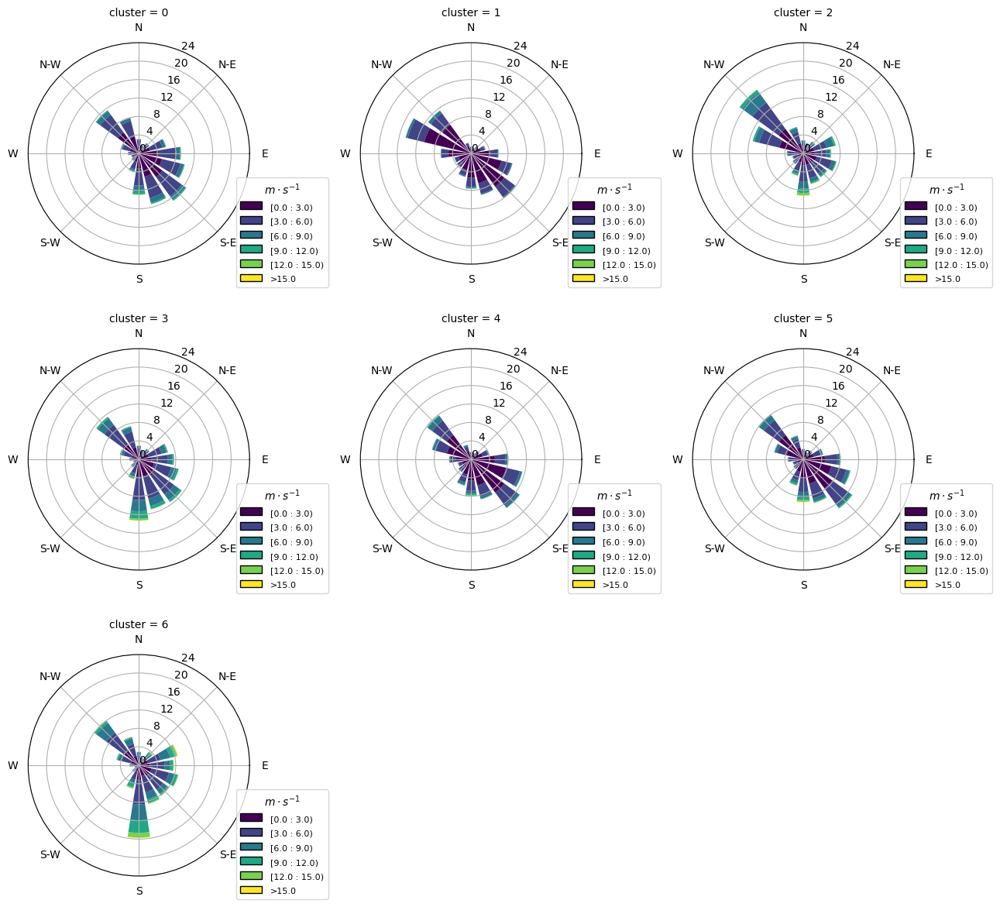

In [42]:
create_cluster_windrose_plots(filtered_species_kmeansclusters, wind_speeds_hourly, wind_directions_hourly)

<h1>KMeans On Filtered PM2.5 Species With PM2.5 Concentrations</h1>

### Set Up Data, Assign Clusters, and Use UMAP to Visualize Cluster Assignments
- Using elbow method on normalized features to determine the 'optimal' number of clusters (k)
- UMAP Visualization used as a sanity check
- Visualization should not be used to check algorithm performance or metrics

In [43]:
filtered_species_kmeans_25 = pm25_csn_df.copy()
filtered_species_kmeans_25.set_index('date_gmt', inplace=True)
filtered_species_kmeans_25 = filtered_species_kmeans_25.filter(['PM2.5', 'Al', 'Br', 'Ca', 'Cr', 'Cu', 'Cl', 'Fe', 'Pb', 'Mn', 'Ni', 'Mg', 'Ti', 'V', 'Si', 'Zn', 'K', 'Na', 'NH4', 'NO3', 'OC', 'EC', 'SO4'])
filtered_species_kmeans_25.head()

,PM2.5,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4
date_gmt,,,,,,,,,,,,,,,,,,,,,,,
2000-02-09,23.7,0.117,0.01030,0.2394,0.001,0.014,0.0180,0.28720,0.02190,0.00820,0.00780,0.009,0.0191,0.00095,0.29580,0.030,0.1092,0.0195,1.7350,6.015,5.015833,3.341,1.183
2000-02-15,3.5,0.005,0.00115,0.0469,0.001,0.004,0.0290,0.07760,0.00315,0.00420,0.00210,0.009,0.0019,0.00095,0.04830,0.003,0.0092,0.0400,0.0710,0.358,1.315833,0.741,0.457
2000-02-21,3.4,0.005,0.00115,0.0023,0.001,0.001,0.0055,0.00165,0.00315,0.00145,0.00095,0.009,0.0019,0.00095,0.00415,0.001,0.0021,0.0420,0.0135,0.601,1.155000,0.624,0.792
2000-02-27,3.9,0.017,0.00115,0.0577,0.001,0.001,0.0160,0.13350,0.00740,0.00145,0.00270,0.009,0.0019,0.00095,0.07740,0.005,0.0182,0.0195,0.1430,0.459,0.965833,0.611,0.541
2000-03-04,21.8,0.005,0.00290,0.1116,0.001,0.006,0.0055,0.20970,0.00840,0.00480,0.00095,0.028,0.0081,0.00095,0.12660,0.020,0.0407,0.1800,2.7530,8.801,3.390000,1.612,1.780


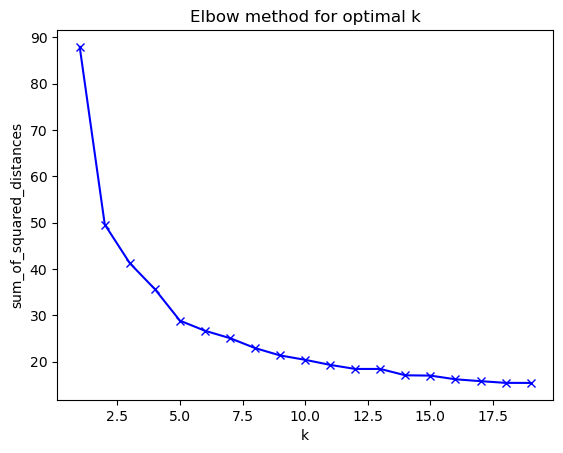

In [44]:
features_normed_25 = normalize(filtered_species_kmeans_25, norm='l2')
find_best_k(features_normed_25)

In [45]:
optimal_k = 5
kmeans = KMeans(n_clusters=optimal_k)
clusters = kmeans.fit_predict(features_normed_25)

filtered_species_kmeansclusters_25 = filtered_species_kmeans_25.copy()
filtered_species_kmeansclusters_25['cluster'] = clusters
print(filtered_species_kmeansclusters_25['cluster'].value_counts())

# Reduce dimensions for visualization with UMAP
umap_3d = UMAP(n_components=3, init='random')
proj_3d = umap_3d.fit_transform(features_normed_25)

# Plotting with Plotly
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], y=proj_3d[:, 1], z=proj_3d[:, 2],
    color=filtered_species_kmeansclusters_25['cluster'].astype(str), 
    labels={'color': 'Cluster'},
    title='3D Scatter Plot of Clusters'
)
fig_3d.update_traces(marker=dict(size=2))
fig_3d.show()

cluster
3    665
0    612
4    523
2    504
1     14
Name: count, dtype: int64


### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [46]:
filtered_species_kmeansclusters_25['Season'] = filtered_species_kmeansclusters_25.index.map(get_season)
seasonal_kmeans_cluster_counts_25 = filtered_species_kmeansclusters_25.groupby(['Season', 'cluster']).size().unstack(fill_value=0)
seasonal_kmeans_cluster_counts_25

cluster,0,1,2,3,4
Season,,,,,
Fall,213,3,67,117,168
Spring,81,6,92,251,157
Summer,294,0,1,266,4
Winter,24,5,344,31,194


In [47]:
seasonal_kmeans_cluster_counts_25.reset_index(inplace=True)

# Exclude cluster -1 from the DataFrame
filtered_kmeans_df_25 = seasonal_kmeans_cluster_counts_25.loc[:, seasonal_kmeans_cluster_counts_25.columns != -1]

# Melt the DataFrame to have clusters as one of the dimensions
melted_df = filtered_kmeans_df_25.melt(id_vars='Season', var_name='cluster', value_name='Number of Days')

# Plotting using Plotly Express
fig = px.bar(melted_df, x='cluster', y='Number of Days', color='Season',
             labels={'cluster': 'Cluster', 'Number of Days': 'Number of Days'},
             title='Seasonal Distribution Across Clusters',
             color_discrete_map={'Winter': '#007291', 'Spring': '#359c00', 'Summer': '#f5c600', 'Fall': '#d8460b'},
             barmode='group')

fig.show()

### Plot Species Distributions Amongst Clusters
- Used for comparing species distributions within clusters
- Helpful for beginning to profile different clusters
- Distributions can be compared to previous source apportionment studies to aid in profiling

In [48]:
species_columns = filtered_species_kmeansclusters_25.columns.difference(['cluster'])
unique_clusters = sorted(filtered_species_kmeansclusters_25['cluster'].unique())
for cluster in unique_clusters:
    # Filter the DataFrame for the current cluster
    cluster_data = filtered_species_kmeansclusters_25[filtered_species_kmeansclusters_25['cluster'] == cluster]
    
    melted_data = cluster_data.melt(id_vars='cluster', value_vars=species_columns, var_name='Species', value_name='Concentration')
    
    fig = px.box(melted_data, x='Species', y='Concentration',
                 title=f'Distribution of PM2.5 Species in Cluster {cluster}',
                 labels={'Species': 'PM2.5 Species', 'Concentration': 'Concentration (ppm)'})
    fig.update_layout(
        height=800,
        width=5000)
    fig.update_xaxes(categoryorder='total descending')
    
    display(HTML('<div style="width: 1000px; overflow-x: auto;">' + fig.to_html(include_plotlyjs='cdn') + '</div>'))

### Plot Cluster Distributions Amongst Species
- Used for comparing cluster distributions to one another for particular species
- Helpful for cluster comparison to better identify and differentiate cluster qualities

In [49]:
 species_columns = filtered_species_kmeansclusters_25.columns.difference(['cluster', 'Season'])

# Exclude cluster -1
filtered_df_25 = filtered_species_kmeansclusters_25[filtered_species_kmeansclusters_25['cluster'] != -1]

# Create a box plot for each species
for species in species_columns:
    fig = px.box(filtered_df_25, x='cluster', y=species,
                 title=f'Distribution of {species} by Cluster',
                 labels={'cluster': 'Cluster', species: f'{species} Concentration'},
                 category_orders={"cluster": sorted(filtered_species_kmeansclusters_25['cluster'].unique())})
    fig.update_layout(height=400)
    fig.show()

In [50]:
for species in species_columns:
    # Calculate mean and median grouped by cluster
    stats_df = filtered_species_kmeansclusters_25.groupby('cluster')[species].agg(['mean', 'median']).reset_index()

    # Create a figure with subplots for mean and median
    fig = go.Figure(data=[
        go.Bar(name='Mean', x=stats_df['cluster'], y=stats_df['mean'], marker_color='#FFBF00'),
        go.Bar(name='Median', x=stats_df['cluster'], y=stats_df['median'], marker_color='#6495ED')
    ])
    
    # Update the layout
    fig.update_layout(
        barmode='group',
        title=f'Distribution of {species} by Cluster: Means and Medians',
        xaxis_title='Cluster',
        yaxis_title=f'{species} Concentration',
        height=400
    )
    
    fig.show()

### Create Heatmap of Species' Log-Distributions Across Clusters
- Easier way to compare species' distributions amongst clusters
- Log scale is used to prevent the domination of one species (PM2.5 has much larger concentrations than other species)

In [51]:
columns_to_include = filtered_species_kmeansclusters_25.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_kmeansclusters_25.groupby('cluster')[columns_to_include_ordered].median()

log_scaled_concentrations = np.log(median_concentrations)

fig = px.imshow(
    log_scaled_concentrations,
    labels=dict(x="Pollutant Types", y="Cluster", color="Log-scaled Concentration"),
    x=log_scaled_concentrations.columns,  # pollutant types as columns
    y=log_scaled_concentrations.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (K-MEANS With PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Log-scaled Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(log_scaled_concentrations.index),
        ticktext=[f"Cluster {c}" for c in log_scaled_concentrations.index]
    )
)

fig.show()

### Create Heatmap of Normalized Species' Concentrations
- Used for comparing species' concentrations across clusters
- Should not be used to determine actual concentration values

In [52]:
columns_to_include = filtered_species_kmeansclusters_25.columns.difference(['Season', 'cluster'])
custom_order = ['PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = filtered_species_kmeansclusters_25.groupby('cluster')[columns_to_include_ordered].median()

scaler = MinMaxScaler()
median_concentrations_normalized = pd.DataFrame(scaler.fit_transform(median_concentrations),
                                                index=median_concentrations.index, 
                                                columns=columns_to_include_ordered)

fig = px.imshow(
    median_concentrations_normalized,
    labels=dict(x="Pollutant Types", y="Cluster", color="Normalized Concentration"),
    x=median_concentrations_normalized.columns,  # pollutant types as columns
    y=median_concentrations_normalized.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster (K-MEANS With PM2.5 Concentrations)",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Normalized Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(median_concentrations_normalized.index),
        ticktext=[f"Cluster {c}" for c in median_concentrations_normalized.index]
    )
)

fig.show()

### Create Windrose Plots for Each Cluster
- Helpful for confirming/developing cluster profiles
- i.e. Winter inversion cluster should have low wind speeds

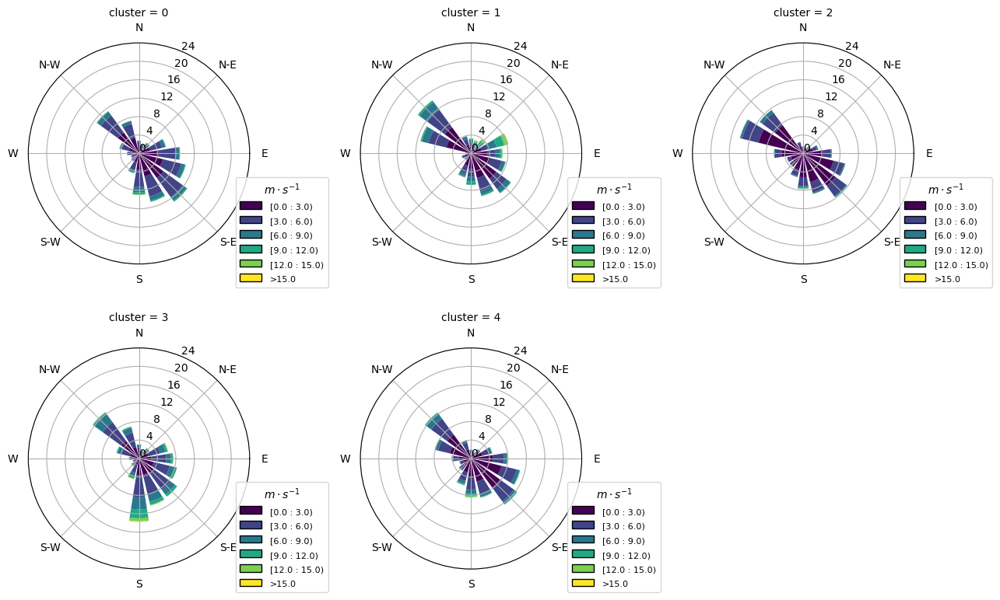

In [53]:
create_cluster_windrose_plots(filtered_species_kmeansclusters_25, wind_speeds_hourly, wind_directions_hourly)

<h1>KMeans On Filtered PM2.5 Species and Other Pollutants</h1>

### Set Up Data, Assign Clusters, and Use UMAP to Visualize Cluster Assignments
- Data includes concentrations of PM2.5 Species, PM10, Ozone, Carbon Monoxide, Nitrogen Oxides, and Sulfur Dioxide
- Using elbow method on normalized features to determine the 'optimal' number of clusters (k)
- UMAP Visualization used as a sanity check
- Visualization should not be used to check algorithm performance or metrics

In [54]:
pm25_csn_df = pd.read_csv('./hawthorne_data/PM25_CSN_Species_imputed.csv')
pm10_df = pd.read_csv('./hawthorne_data/86101_2011To2021_Every3.csv')
co_df = pd.read_csv('./hawthorne_data/42101_2000To2021_Every3.csv')
ozone_df = pd.read_csv('./hawthorne_data/44201_2000To2021_Every3.csv')
nox_df = pd.read_csv('./hawthorne_data/42603_2000To2021_Every3.csv')
so2_df = pd.read_csv('./hawthorne_data/42401_2011To2021_Every3.csv')

pm10_df.rename(columns={'sample_measurement': 'PM10'}, inplace=True)
co_df.rename(columns={'arithmetic_mean': 'CO', 'date_local': 'date_gmt'}, inplace=True)
ozone_df.rename(columns={'derived_daily_mean': 'Ozone', 'date_local': 'date_gmt'}, inplace=True)
nox_df.rename(columns={'derived_daily_mean': 'NOx', 'date_local': 'date_gmt'}, inplace=True)
so2_df.rename(columns={'derived_daily_mean': 'SO2', 'date_local': 'date_gmt'}, inplace=True)

filtered_species_kmeans_25 = pm25_csn_df.filter(['date_gmt', 'PM2.5', 'Al', 'Br', 'Ca', 'Cr', 'Cu', 'Cl', 'Fe', 'Pb', 'Mn', 'Ni', 'Mg', 'Ti', 'V', 'Si', 'Zn', 'K', 'Na', 'NH4', 'NO3', 'OC', 'EC', 'SO4'])
pm10_df = pm10_df.filter(['date_gmt', 'PM10'])
co_df = co_df.filter(['date_gmt', 'CO'])
ozone_df = ozone_df.filter(['date_gmt', 'Ozone'])
nox_df = nox_df.filter(['date_gmt', 'NOx'])
so2_df = so2_df.filter(['date_gmt', 'SO2'])

filtered_species_kmeans_25['date_gmt'] = pd.to_datetime(filtered_species_kmeans_25['date_gmt'])
pm10_df['date_gmt'] = pd.to_datetime(pm10_df['date_gmt'])
co_df['date_gmt'] = pd.to_datetime(co_df['date_gmt'])
ozone_df['date_gmt'] = pd.to_datetime(ozone_df['date_gmt'])
nox_df['date_gmt'] = pd.to_datetime(nox_df['date_gmt'])
so2_df['date_gmt'] = pd.to_datetime(so2_df['date_gmt'])

from functools import reduce
dfs = [filtered_species_kmeans_25, pm10_df, co_df, ozone_df, nox_df, so2_df]
matrix = reduce(lambda left, right: pd.merge(left, right, on='date_gmt', how='inner'), dfs)

matrix.head()

,date_gmt,PM2.5,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4,PM10,CO,Ozone,NOx,SO2
0,2011-01-01,15.1,0.0310,0.0086,0.0164,0.0020,0.0149,0.218,0.0373,0.0029,0.0008,0.00085,0.0310,0.0025,0.00160,0.0090,0.0082,0.5480,0.0550,0.784,2.61,3.67865,1.49613,0.879,12.9,0.554167,0.011917,59.125000,1.020833
1,2011-01-05,49.0,0.0115,0.0196,0.0647,0.0120,0.0292,2.570,0.2530,0.0237,0.0090,0.00400,0.0090,0.0025,0.00165,0.0860,0.0302,0.0870,0.1180,7.480,19.30,5.01500,2.15968,1.800,24.0,1.118182,0.003864,148.772727,1.590909
2,2011-01-07,65.3,0.0980,0.0642,0.0361,0.0011,0.0139,2.510,0.2110,0.0876,0.0088,0.00250,0.0055,0.0062,0.00150,0.1240,0.0344,0.0537,0.0200,11.800,25.40,5.77865,1.81968,5.590,14.7,0.725000,0.004958,106.041667,1.450000
3,2011-01-09,25.8,0.0680,0.0540,0.0136,0.0100,0.0044,0.531,0.0779,0.0114,0.0008,0.00420,0.0090,0.0025,0.00160,0.0280,0.0063,0.0520,0.0270,3.940,10.50,3.02865,0.84868,1.810,12.2,0.408333,0.011833,45.000000,1.045833
4,2011-01-13,36.6,0.0260,0.0674,0.0572,0.0020,0.0060,1.770,0.2100,0.0126,0.0051,0.00095,0.0090,0.0061,0.00095,0.0752,0.0420,0.0461,0.0195,6.160,16.30,3.89865,1.31968,1.230,NaN,0.691304,0.004217,97.217391,1.934783


In [55]:
matrix.set_index('date_gmt', inplace=True)

imputer = KNNImputer(n_neighbors=5, weights="uniform")

imputed_data = imputer.fit_transform(matrix)

imputed_matrix = pd.DataFrame(imputed_data, columns=matrix.columns, index=matrix.index)

imputed_matrix.head()

,PM2.5,Al,Br,Ca,Cr,Cu,Cl,Fe,Pb,Mn,Ni,Mg,Ti,V,Si,Zn,K,Na,NH4,NO3,OC,EC,SO4,PM10,CO,Ozone,NOx,SO2
date_gmt,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-01,15.1,0.0310,0.0086,0.0164,0.0020,0.0149,0.218,0.0373,0.0029,0.0008,0.00085,0.0310,0.0025,0.00160,0.0090,0.0082,0.5480,0.0550,0.784,2.61,3.67865,1.49613,0.879,12.90,0.554167,0.011917,59.125000,1.020833
2011-01-05,49.0,0.0115,0.0196,0.0647,0.0120,0.0292,2.570,0.2530,0.0237,0.0090,0.00400,0.0090,0.0025,0.00165,0.0860,0.0302,0.0870,0.1180,7.480,19.30,5.01500,2.15968,1.800,24.00,1.118182,0.003864,148.772727,1.590909
2011-01-07,65.3,0.0980,0.0642,0.0361,0.0011,0.0139,2.510,0.2110,0.0876,0.0088,0.00250,0.0055,0.0062,0.00150,0.1240,0.0344,0.0537,0.0200,11.800,25.40,5.77865,1.81968,5.590,14.70,0.725000,0.004958,106.041667,1.450000
2011-01-09,25.8,0.0680,0.0540,0.0136,0.0100,0.0044,0.531,0.0779,0.0114,0.0008,0.00420,0.0090,0.0025,0.00160,0.0280,0.0063,0.0520,0.0270,3.940,10.50,3.02865,0.84868,1.810,12.20,0.408333,0.011833,45.000000,1.045833
2011-01-13,36.6,0.0260,0.0674,0.0572,0.0020,0.0060,1.770,0.2100,0.0126,0.0051,0.00095,0.0090,0.0061,0.00095,0.0752,0.0420,0.0461,0.0195,6.160,16.30,3.89865,1.31968,1.230,18.62,0.691304,0.004217,97.217391,1.934783


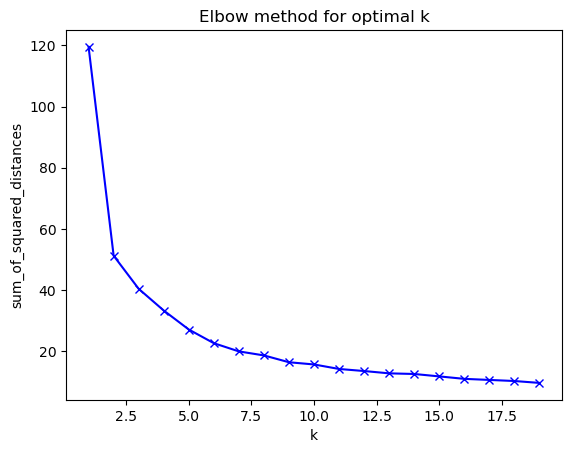

In [56]:
matrix_features_normed = normalize(imputed_matrix, norm='l2')

find_best_k(matrix_features_normed)

In [57]:
optimal_k = 7
kmeans = KMeans(n_clusters=optimal_k)
clusters = kmeans.fit_predict(matrix_features_normed)

imputed_matrix_clusters = imputed_matrix.copy()
imputed_matrix_clusters['cluster'] = clusters
print(imputed_matrix_clusters['cluster'].value_counts())

# Reduce dimensions for visualization with UMAP
umap_3d = UMAP(n_components=3, init='random')
proj_3d = umap_3d.fit_transform(matrix_features_normed)

# Plotting with Plotly
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], y=proj_3d[:, 1], z=proj_3d[:, 2],
    color=imputed_matrix_clusters['cluster'].astype(str), 
    labels={'color': 'Cluster'},
    title='3D Scatter Plot of Clusters'
)
fig_3d.update_traces(marker=dict(size=2))
fig_3d.show()

cluster
5    253
4    228
1    176
3    156
2     70
6     67
0     57
Name: count, dtype: int64


### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [58]:
imputed_matrix_clusters['Season'] = imputed_matrix_clusters.index.map(get_season)
matrix_cluster_counts = imputed_matrix_clusters.groupby(['Season', 'cluster']).size().unstack(fill_value=0)
matrix_cluster_counts

cluster,0,1,2,3,4,5,6
Season,,,,,,,
Fall,6,39,3,19,62,74,17
Spring,25,59,19,32,37,85,5
Summer,18,54,0,96,0,4,45
Winter,8,24,48,9,129,90,0


In [59]:
matrix_cluster_counts.reset_index(inplace=True)

# Melt the DataFrame to have clusters as one of the dimensions
melted_df = matrix_cluster_counts.melt(id_vars='Season', var_name='cluster', value_name='Number of Days')

# Plotting using Plotly Express
fig = px.bar(melted_df, x='cluster', y='Number of Days', color='Season',
             labels={'cluster': 'Cluster', 'Number of Days': 'Number of Days'},
             title='Seasonal Distribution Across Clusters',
             color_discrete_map={'Winter': '#007291', 'Spring': '#359c00', 'Summer': '#f5c600', 'Fall': '#d8460b'},
             barmode='group')

fig.show()

### Determine Seasonal Cluster Counts and Plot
- Seasonal counts can be used as a first step in determining cluster qualities/behaviors
- i.e. Cluster with mostly winter days could be a cluster that represents wintertime inversions

In [60]:
species_columns = imputed_matrix_clusters.columns.difference(['cluster'])
unique_clusters = sorted(imputed_matrix_clusters['cluster'].unique())
for cluster in unique_clusters:
    # Filter the DataFrame for the current cluster
    cluster_data = imputed_matrix_clusters[imputed_matrix_clusters['cluster'] == cluster]
    
    melted_data = cluster_data.melt(id_vars='cluster', value_vars=species_columns, var_name='Species', value_name='Concentration')
    
    fig = px.box(melted_data, x='Species', y='Concentration',
                 title=f'Distribution of PM2.5 Species in Cluster {cluster}',
                 labels={'Species': 'PM2.5 Species', 'Concentration': 'Concentration (ppm)'})
    fig.update_layout(
        height=800,
        width=5000)
    fig.update_xaxes(categoryorder='total descending')
    
    display(HTML('<div style="width: 1000px; overflow-x: auto;">' + fig.to_html(include_plotlyjs='cdn') + '</div>'))

### Plot Cluster Distributions Amongst Species
- Used for comparing cluster distributions to one another for particular species
- Helpful for cluster comparison to better identify and differentiate cluster qualities

In [61]:
species_columns = imputed_matrix_clusters.columns.difference(['cluster', 'Season'])
# Create a box plot for each species
for species in species_columns:
    fig = px.box(imputed_matrix_clusters, x='cluster', y=species,
                 title=f'Distribution of {species} by Cluster',
                 labels={'cluster': 'Cluster', species: f'{species} Concentration'},
                 category_orders={"cluster": sorted(imputed_matrix_clusters['cluster'].unique())})
    fig.update_layout(height=400)
    fig.show()

### Create Heatmap of Species' Log-Distributions Across Clusters
- Easier way to compare species' distributions amongst clusters
- Log scale is used to prevent the domination of one species (PM2.5 has much larger concentrations than other species)

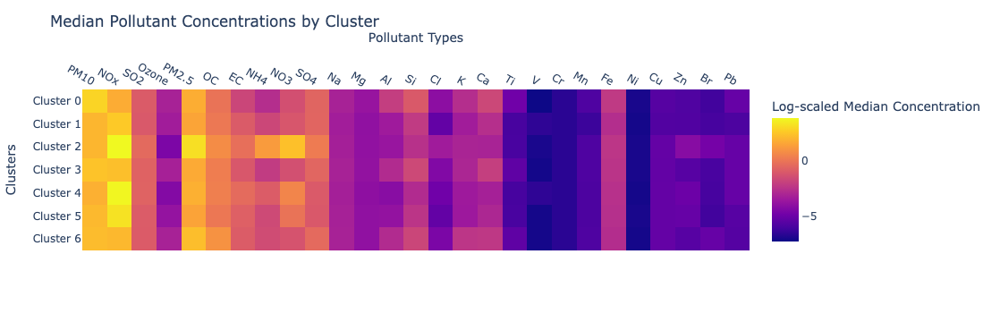

In [65]:
columns_to_include = imputed_matrix_clusters.columns.difference(['Season', 'cluster'])
custom_order = ['PM10', 'NOx', 'SO2', 'Ozone', 'PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']
columns_to_include_ordered = [col for col in custom_order if col in columns_to_include]

median_concentrations = imputed_matrix_clusters.groupby('cluster')[columns_to_include_ordered].median()

log_scaled_concentrations = np.log(median_concentrations)

fig = px.imshow(
    log_scaled_concentrations,
    labels=dict(x="Pollutant Types", y="Cluster", color="Log-scaled Concentration"),
    x=log_scaled_concentrations.columns,  # pollutant types as columns
    y=log_scaled_concentrations.index,    # clusters as rows
    aspect="auto",
    title="Median Pollutant Concentrations by Cluster",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Log-scaled Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(log_scaled_concentrations.index),
        ticktext=[f"Cluster {c}" for c in log_scaled_concentrations.index]
    ),
    margin=dict(t=100),
    title_y=0.95
)

fig.show()

### Create Heatmap of Normalized Species' Concentrations
- Used for comparing species' concentrations across clusters
- Should not be used to determine actual concentration values

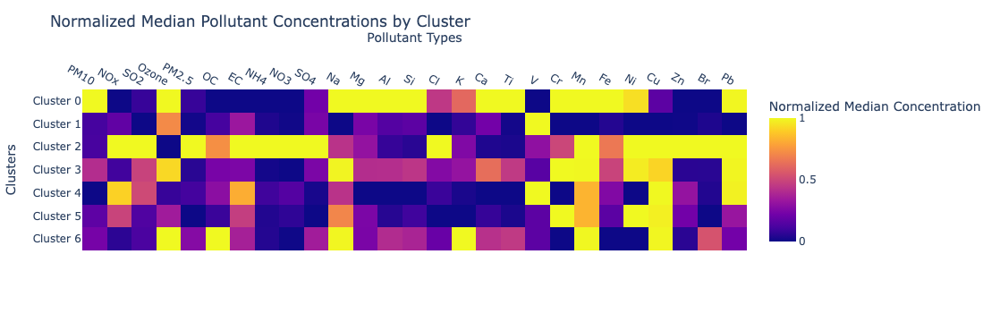

In [63]:
columns_to_include = imputed_matrix_clusters.columns.difference(['Season', 'cluster'])
custom_order = ['PM10', 'NOx', 'SO2', 'Ozone', 'PM2.5', 'OC', 'EC', 'NH4', 'NO3', 'SO4', 'Na', 'Mg', 'Al', 'Si', 'Cl', 'K', 'Ca', 'Ti', 'V', 'Cr', 'Mn', 'Fe', 'Ni', 'Cu', 'Zn', 'Br', 'Pb']

median_concentrations = imputed_matrix_clusters.groupby('cluster')[columns_to_include_ordered].median()

scaler = MinMaxScaler()
median_concentrations_normalized = pd.DataFrame(scaler.fit_transform(median_concentrations),
                                                index=median_concentrations.index, 
                                                columns=columns_to_include_ordered)

fig = px.imshow(
    median_concentrations_normalized,
    labels=dict(x="Pollutant Types", y="Cluster", color="Normalized Concentration"),
    x=median_concentrations_normalized.columns,  # pollutant types as columns
    y=median_concentrations_normalized.index,    # clusters as rows
    aspect="auto",
    title="Normalized Median Pollutant Concentrations by Cluster",
    color_continuous_scale='plasma'
)

fig.update_layout(
    xaxis_title="Pollutant Types",
    yaxis_title="Clusters",
    xaxis={'side': 'top'},
    coloraxis_colorbar={'title': 'Normalized Median Concentration'},
    yaxis=dict(
        tickmode='array',
        tickvals=list(median_concentrations_normalized.index),
        ticktext=[f"Cluster {c}" for c in median_concentrations_normalized.index]
    ),
    margin=dict(t=100),
    title_y=0.95
)

fig.show()

### Create Windrose Plots for Each Cluster
- Helpful for confirming/developing cluster profiles
- i.e. Winter inversion cluster should have low wind speeds

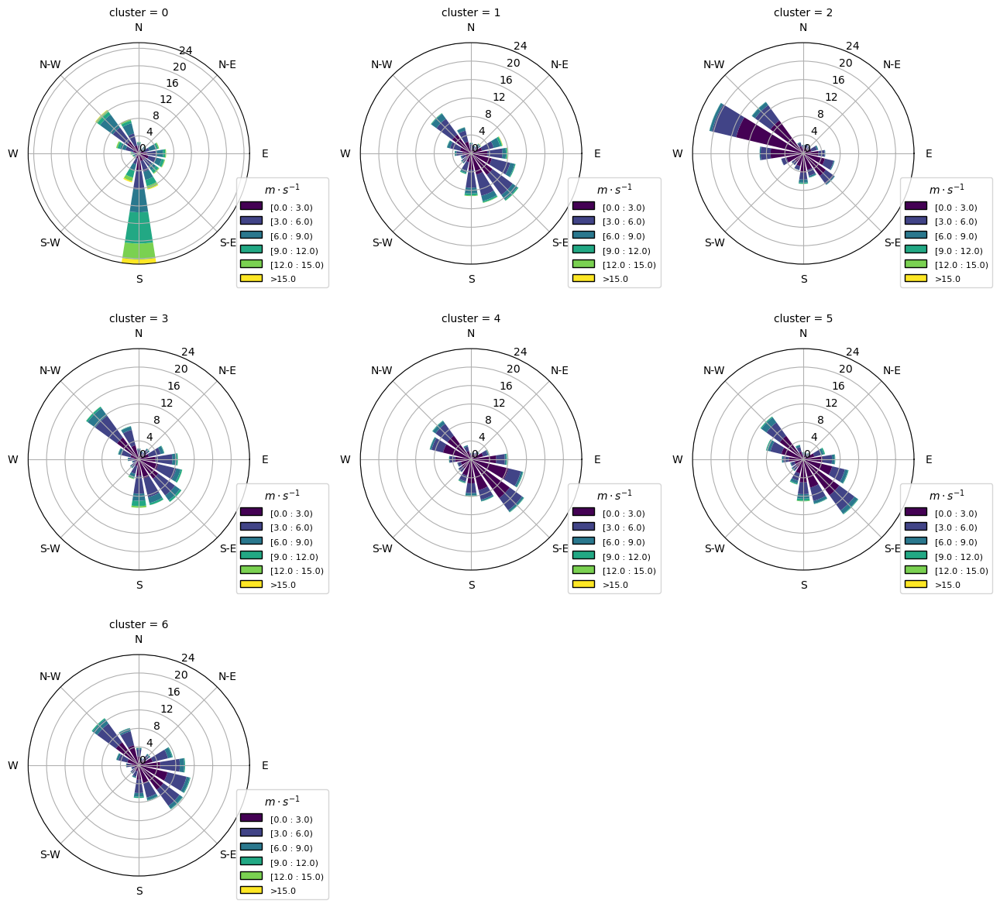

In [64]:
create_cluster_windrose_plots(imputed_matrix_clusters, wind_speeds_hourly, wind_directions_hourly)